In [1]:
from glob import glob
import numpy as np
import os
from autoload_models import *

import torch
from lucent.modelzoo import vgg19, util
from lucent.optvis import render, param, transform, objectives

import matplotlib.pyplot as plt
import itertools
import os


all_transforms = [
    transform.jitter(10),
]


folder = 'Results_no_transform'
os.mkdir(folder)

neurons_per_roi = {1: 43, 2: 62, 3: 55, 4: 50, 5: 51, 7: 53, 8: 60, 9: 43, 10: 44, 11: 53, 12: 29, 13: 17, 14: 24, 15: 59, 16: 24}


vgg_layers = [0,2,5,7,10,12,14,16,19,21,23,25,28,30,32,34]
layer_options  = ['conv2d0', 'conv2d1', 'conv2d2', 'mixed4a', 'mixed4b', 'mixed4c', 'mixed4d', 'mixed4e', 'mixed5a', 'mixed5b']
rois = list(range(1,17))




########  Cadena Vgg  ###########

os.mkdir(f'{folder}/Cadena_Vgg')

for roi, vgg_layer in itertools.product(rois, vgg_layers):
    net = CadenaVgg(roi, vgg_layer)

    param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
    cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
    obj = objectives.channel('output', np.array(list(range(neurons_per_roi[roi])))) # Still need to add the correlation stuff here
    img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=False)

    np.save(f'roi_{roi}_layer_{vgg_layer}', img[0])
    f, ax = plt.subplot(1, 5, figsize = (2,10))
    for i in range(5):
        ax[i].imshow(img[0][i, :])
    plt.savefig(f'Img_roi_{roi}_layer_{vgg_layer}.png', dpi = 150)
    
    

FileExistsError: [Errno 17] File exists: 'Results_no_transform'

In [1]:
from glob import glob
import numpy as np
import os
from autoload_models import *

import torch
from lucent.modelzoo import vgg19, util
from lucent.optvis import render, param, transform, objectives
import itertools
import matplotlib.pyplot as plt

from lucent.util import set_seed


neurons_per_roi = {1: 43, 2: 62, 3: 55, 4: 50, 5: 51, 7: 53, 8: 60, 9: 43, 10: 44, 11: 53, 12: 29, 13: 17, 14: 24, 15: 59, 16: 24}

vgg_layers = [0,2,5,7,10,12,14,16,19,21,23,25,28,30,32,34]
inception_layers  = ['conv2d0', 'conv2d1', 'conv2d2', 'mixed4a', 'mixed4b', 'mixed4c', 'mixed4d', 'mixed4e', 'mixed5a', 'mixed5b']
rois = list(range(1,17))

In [2]:
try:
    print(FindLowestBashivanVgg(15, 7))
except:
    print('pass')
    pass

/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_15_Layer_7/ROI_15_Layer_7_0/Bashivan_Vgg_15_7_epoch_14_loss_0.20316674566341852_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


In [7]:
for (roi, layer) in itertools.product(rois, vgg_layers):

    print(f'\n\n Bashivan Vgg: Roi {roi}  Layer: {layer}')

    all_transforms = [
        transform.jitter(10),
    ]

    if not os.path.exists('Results_no_transform'):
        os.mkdir('Results_no_transform')

    os.chdir('Results_no_transform')

    if not os.path.exists('Bashivan_Vgg'):
        os.mkdir('Bashivan_Vgg')

    os.chdir('Bashivan_Vgg')

    net = None
    net = BashivanVgg(roi, layer)

    print('---',net)

    if net != 0:
        param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
        cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
        obj = objectives.channel('output', np.array(list(range(neurons_per_roi[roi])))) # Still need to add the correlation stuff here
        img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=False)

        np.save(f'Bashivan_Vgg_roi_{args.roi}_layer_{args.layer}', img[0])
        f, ax = plt.subplots(1, 5, figsize = (45, 10))
        for i in range(5):
            ax[i].imshow(img[0][i, :])
            ax[i].set_axis_off()

        plt.savefig(f'Bashivan_Vgg_Img_roi_{roi}_layer_{layer}.png', dpi = 150)

    os.chdir('/home/jose/Desktop/lucent-things/')



 Bashivan Vgg: Roi 1  Layer: 0


/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


features.0
Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 2
features.2
Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 5
features.5
Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 7
features.7
Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 10
features.10
Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 12
features.12
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
No available model with those parameters
--- 0


 Bashivan Vgg: Roi 1  Layer: 14
features.14
Conv2d(256, 256, kernel_size=(3, 3)

  0%|          | 0/512 [00:00<?, ?it/s]

In [ ]:
!python GENERATE_IMAGES__Bashivan_Vgg.py 

In [5]:
roi = 2
layer = 16
net = BashivanVgg(roi, layer)

/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


features.16
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_2_Layer_16/ROI_2_Layer_16_0/Bashivan_Vgg_2_16_epoch_11_loss_0.07807785003682119_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_2_16_epoch_11_loss_0.07807785003682119_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


In [7]:
roi = 12
layer = 'conv2d0'
net = BashivanInception(roi, layer)

conv2d0
RedirectedReluLayer()
/home/jose/Desktop/lucent-things/Results_Bashivan_Inception/ROI_12_Layer_conv2d0/ROI_12_Layer_conv2d0_0_Inception/Bashivan_Inception_12_conv2d0_epoch_15_loss_0.07304873936860563_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Inception_12_conv2d0_epoch_15_loss_0.07304873936860563_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


In [12]:
roi = 2
layer = 5
net = BashivanVgg(roi, layer)

features.5
Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_2_Layer_5/ROI_2_Layer_5_0/Bashivan_Vgg_2_5_epoch_40_loss_0.0874572374589059_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_2_5_epoch_40_loss_0.0874572374589059_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


In [2]:
#all_transforms = [ ## <--- parameters
#transform.pad(2),
#transform.jitter(8),
#transform.random_scale([n/1000. for n in range(975, 1050)]),
#transform.random_rotate(list(range(-5,5))),
#transform.jitter(4)
#]

#This cannot be seeded (what a pity)

all_transforms = [
    transform.jitter(10),
]

param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(neurons_per_roi[roi]))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)



np.save(f'/home/jose/Desktop/lucent-things/Results_no_transform/Bashivan_Vgg/Bashivan_Vgg_roi_{roi}_layer_{layer}', img[0])
f, ax = plt.subplots(1, 5, figsize = (45, 10))
for i in range(5):
    ax[i].imshow(img[0][i, :])
    ax[i].set_axis_off()

plt.savefig(f'/home/jose/Desktop/lucent-things/Results_no_transform/Bashivan_Vgg_Img_roi_{roi}_layer_{layer}.png', dpi = 150)

NameError: name 'roi' is not defined

/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


features.34
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_34/ROI_16_Layer_34_0/Bashivan_Vgg_16_34_epoch_10_loss_0.04302387405273493_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_34_epoch_10_loss_0.04302387405273493_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 34


100%|██████████| 512/512 [00:35<00:00, 14.39it/s]



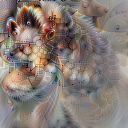
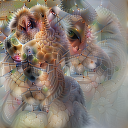
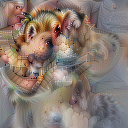
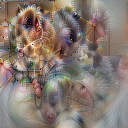
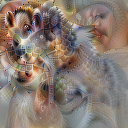

features.32
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_32/ROI_16_Layer_32_0/Bashivan_Vgg_16_32_epoch_15_loss_0.0404723404851811_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_32_epoch_15_loss_0.0404723404851811_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 32


100%|██████████| 512/512 [00:34<00:00, 14.79it/s]



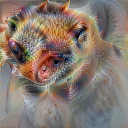
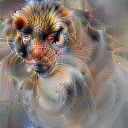
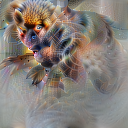
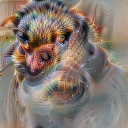
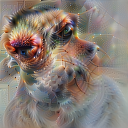

features.30
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_30/ROI_16_Layer_30_0/Bashivan_Vgg_16_30_epoch_7_loss_0.036080334733561606_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_30_epoch_7_loss_0.036080334733561606_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 30


100%|██████████| 512/512 [00:33<00:00, 15.14it/s]



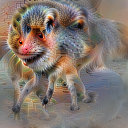
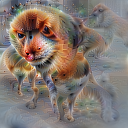
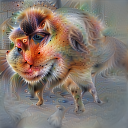
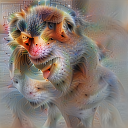
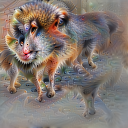

features.28
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_28/ROI_16_Layer_28_0/Bashivan_Vgg_16_28_epoch_7_loss_0.04182230705027257_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_28_epoch_7_loss_0.04182230705027257_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 28


100%|██████████| 512/512 [00:33<00:00, 15.29it/s]



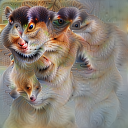
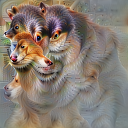
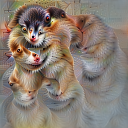
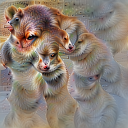
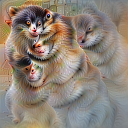

features.25
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_25/ROI_16_Layer_25_0/Bashivan_Vgg_16_25_epoch_11_loss_0.041555737286839374_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_25_epoch_11_loss_0.041555737286839374_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 25


100%|██████████| 512/512 [05:00<00:00,  1.70it/s]



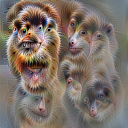
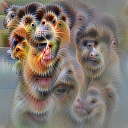
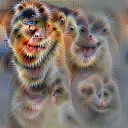
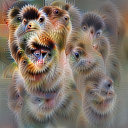
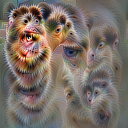

features.23
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_23/ROI_16_Layer_23_0/Bashivan_Vgg_16_23_epoch_15_loss_0.045101429289492796_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_23_epoch_15_loss_0.045101429289492796_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 23


100%|██████████| 512/512 [05:10<00:00,  1.65it/s]



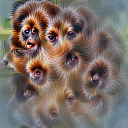
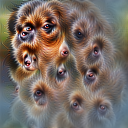
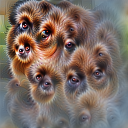
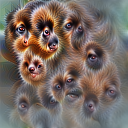
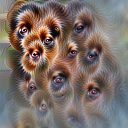

features.21
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_21/ROI_16_Layer_21_0/Bashivan_Vgg_16_21_epoch_15_loss_0.0472054620998041_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_21_epoch_15_loss_0.0472054620998041_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 21


100%|██████████| 512/512 [05:49<00:00,  1.46it/s]



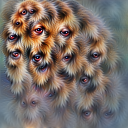
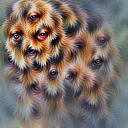
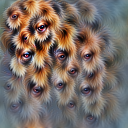
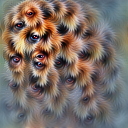
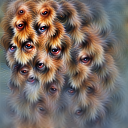

features.19
Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_19/ROI_16_Layer_19_0/Bashivan_Vgg_16_19_epoch_15_loss_0.057860036957068345_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_19_epoch_15_loss_0.057860036957068345_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 19


100%|██████████| 512/512 [06:09<00:00,  1.39it/s]



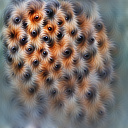
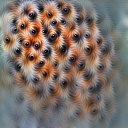
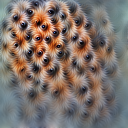
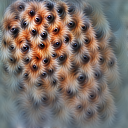
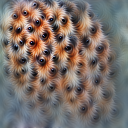

features.16
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
/home/jose/Desktop/lucent-things/Results_Bashivan_Vgg/ROI_16_Layer_16/ROI_16_Layer_16_0/Bashivan_Vgg_16_16_epoch_15_loss_0.08189955600749736_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt


Loaded Bashivan_Vgg_16_16_epoch_15_loss_0.08189955600749736_smoothweight_0.01_sparseweight_1e-08_weightdecay_0.001.pt
Roi: 16   Layer: 16


  0%|          | 2/512 [00:16<1:09:40,  8.20s/it]


OutOfMemoryError: CUDA out of memory. Tried to allocate 62.00 MiB (GPU 0; 11.77 GiB total capacity; 6.93 GiB already allocated; 65.44 MiB free; 7.12 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

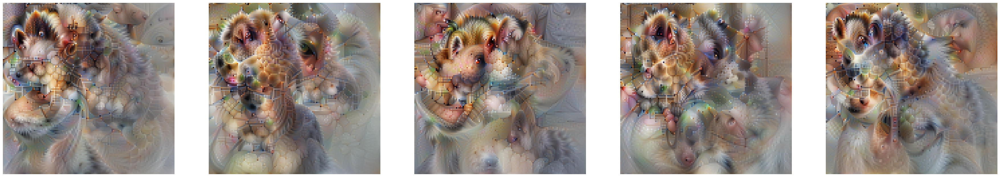

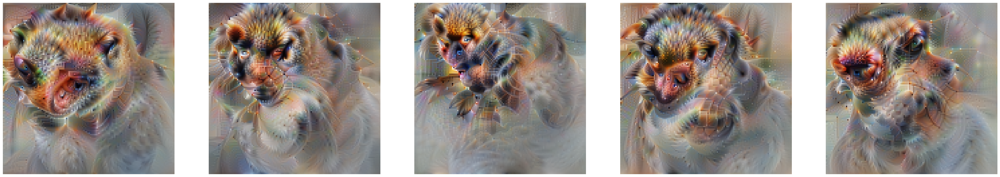

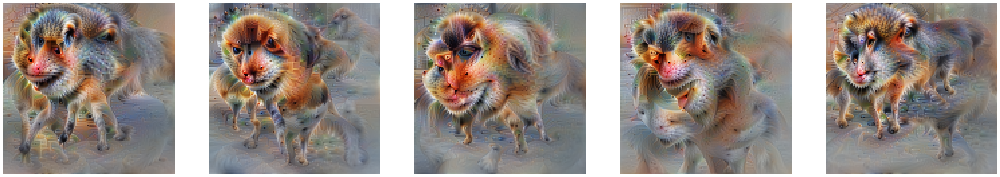

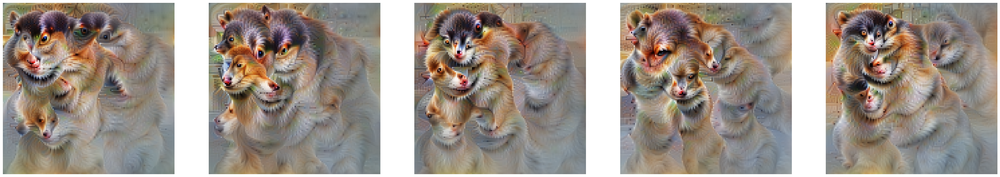

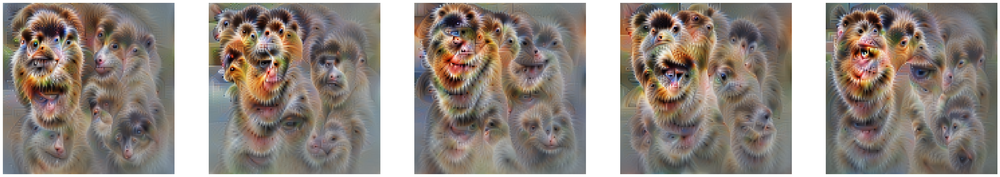

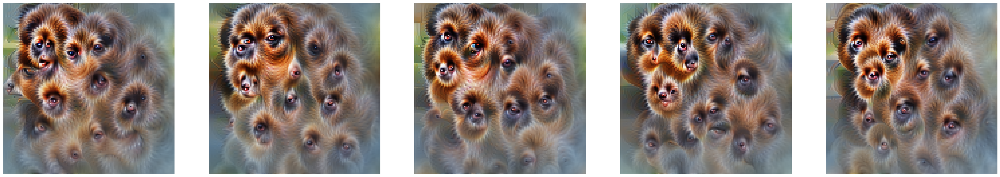

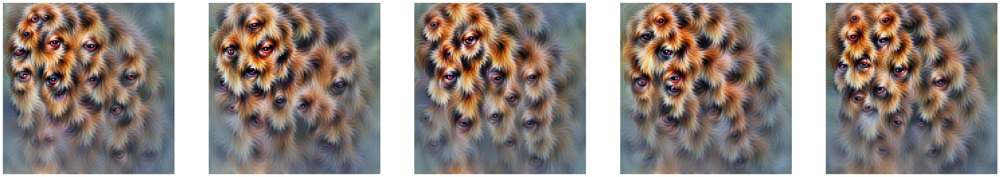

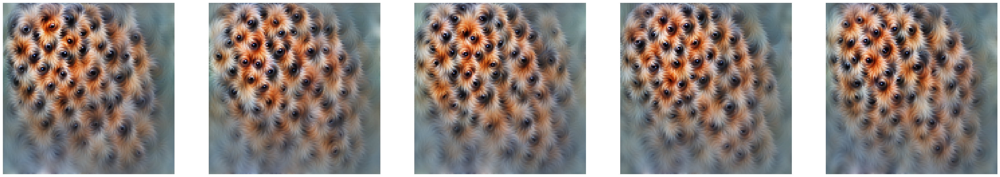

In [3]:
for (roi, layer) in itertools.product(rois[::-1], vgg_layers[::-1]):

    net = BashivanVgg(roi, layer)
    if net!=0:

        print(f'Roi: {roi}   Layer: {layer}')
        all_transforms = [
            transform.jitter(10),
        ]

        param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
        cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
        obj = objectives.channel('output', np.array(list(range(neurons_per_roi[roi]))))
        img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)


        np.save(f'/home/jose/Desktop/lucent-things/Results_no_transform/Bashivan_Vgg/Bashivan_Vgg_roi_{roi}_layer_{layer}', img[0])
        f, ax = plt.subplots(1, 5, figsize = (45, 10))
        for i in range(5):
            ax[i].imshow(img[0][i, :])
            ax[i].set_axis_off()

        plt.savefig(f'/home/jose/Desktop/lucent-things/Results_no_transform/Bashivan_Vgg/Bashivan_Vgg_Img_roi_{roi}_layer_{layer}.png', dpi = 150)


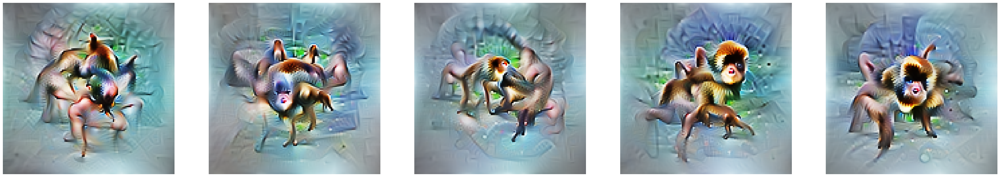

In [35]:
f, ax = plt.subplots(1, 5, figsize = (45, 10))
for i in range(5):
    ax[i].imshow(img[0][i, :]) 
    ax[i].set_axis_off()

plt.savefig('/home/jose/Desktop/test.png', dpi = 150)

In [ ]:
plt.imshow()

100%|██████████| 512/512 [00:51<00:00,  9.90it/s]



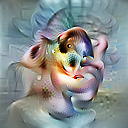
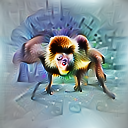
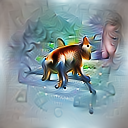
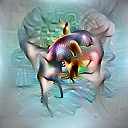
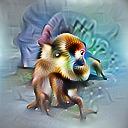

In [13]:
#all_transforms = [ ## <--- parameters
#transform.pad(2),
#transform.jitter(8),
#transform.random_scale([n/1000. for n in range(975, 1050)]),
#transform.random_rotate(list(range(-5,5))),
#transform.jitter(4)
#]

all_transforms = [
    transform.jitter(10),
]

param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(neurons_per_roi[roi]))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)

import torch
from lucent.modelzoo import vgg19, util
from MODEL_cadena_model_vgg import VggModel
from lucent.optvis import render, param, transform, objectives

vgg_pretrained = vgg19(pretrained = True)

gpu_to_use = 0
n_neurons = 29
layer = 12


GPU = torch.cuda.is_available()
net = VggModel(pretrained_model=vgg_pretrained, conv_layer=28, num_neurons=29, device = torch.device("cuda:"+str(gpu_to_use) if GPU else "cpu")).eval()
net.cuda()


#net.load_state_dict(torch.load('E:/Jose/models\\model_9_0_1668242975_epoch_2_loss_0.21454372439322444.pt', map_location=torch.device("cuda:"+str(gpu_to_use) if GPU else "cpu")))
#model_to_load = 'E:/Jose/Results/ROI_3_Layer_10/ROI_3_Layer_10_0/Vgg_model_3_10_epoch_19_loss_0.09356637168213405.pt'
model_to_load = FindLowestCadenaModelVgg(12,28)
net.load_state_dict(torch.load(model_to_load, map_location=torch.device("cuda:"+str(gpu_to_use) if GPU else "cpu")))

In [10]:
roi = 12
layer = 'mixed5a'
net = CadenaInception(roi, layer)

Layer:   mixed5a <class 'str'>
FTE:          ['conv2d2', 'mixed4d', 'mixed4a']
conv in FTE False



mixed5a
CatLayer()
[832, 7, 7, 29]
/home/jose/Desktop/lucent-things/Results_Cadena_Inception/ROI_12_Layer_mixed5a/ROI_12_Layer_mixed5a_0_/Inception_model_12_mixed5a_epoch_9_loss_0.03945914276560144_sparsity_0.01_smoothness_0.1_groupsparsity_0.001.pt


Loaded Inception_model_12_mixed5a_epoch_9_loss_0.03945914276560144_sparsity_0.01_smoothness_0.1_groupsparsity_0.001.pt


In [12]:
#all_transforms = [ ## <--- parameters
#transform.pad(2),
#transform.jitter(8),
#transform.random_scale([n/1000. for n in range(975, 1050)]),
#transform.random_rotate(list(range(-5,5))),
#transform.jitter(4)
#]

all_transforms = [
    transform.jitter(10),
]

all_transforms = [ ## <--- parameters
#transform.pad(2),  ##  <--- activating this breaks all down
transform.jitter(8),
transform.random_scale([n/1000. for n in range(975, 1050)]),
transform.random_rotate(list(range(-5,5))),
transform.jitter(4)
]

param_f = lambda: param.image(256, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(29))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)

  0%|          | 0/512 [00:00<?, ?it/s]/home/jose/Desktop/lucent-things/lucent/optvis/render.py:102: UserWarning: Some layers could not be computed because the size of the image is not big enough. It is fine, as long as the noncomputed layers are not used in the objective function(exception details: 'contracted dimensions need to match, but first has size 8 in dim 2 and second has size 7 in dim 1')
  warnings.warn(
  0%|          | 0/512 [00:00<?, ?it/s]


AssertionError: There are no saved feature maps. Make sure to put the model in eval mode, like so: `model.to(device).eval()`. See README for example.

In [10]:
img[0].shape

(1, 128, 128, 3)

100%|██████████| 512/512 [01:12<00:00,  7.03it/s]



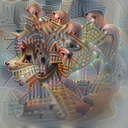
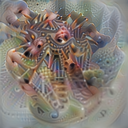
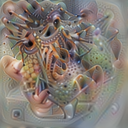
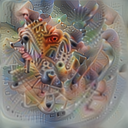
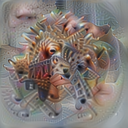

In [5]:
all_transforms = [ ## <--- parameters
#transform.pad(2),  ##  <--- activating this breaks all down
transform.jitter(8),
transform.random_scale([n/1000. for n in range(975, 1050)]),
transform.random_rotate(list(range(-5,5))),
transform.jitter(4)
]

param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(29))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)

100%|██████████| 512/512 [01:14<00:00,  6.92it/s]



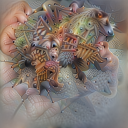
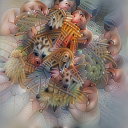
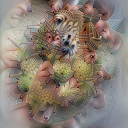
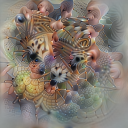
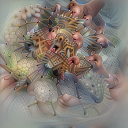

In [6]:
all_transforms = [ ## <--- parameters
#transform.pad(2),
transform.jitter(8),
#transform.random_rotate([10,20,30,40,50,60,70,80]),
transform.random_scale([1,2,3,4,5]),
transform.random_rotate([10,20,30,40,50])
]

param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(29))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)

100%|██████████| 512/512 [01:28<00:00,  5.79it/s]



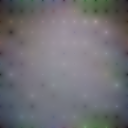
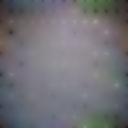
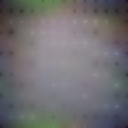
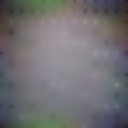
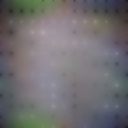

In [12]:
all_transforms = [ ## <--- parameters
#transform.pad(2),
#transform.jitter(8),
#transform.pad(10),
transform.random_scale([.1]),
transform.random_rotate([10,20,30,40,50, 100]),
transform.jitter(10),
]

param_f = lambda: param.image(128, fft=True, batch = 5, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)
obj = objectives.channel('output', np.array(list(range(29))))
img = render.render_vis(net, obj, param_f, cppn_opt, transforms=all_transforms, show_inline=True)

0
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.66it/s]



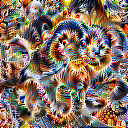

1
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.17it/s]



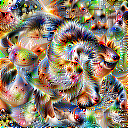

2
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.82it/s]



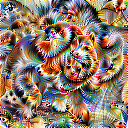

3
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.82it/s]



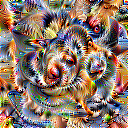

4
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.08it/s]



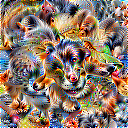

5
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.49it/s]



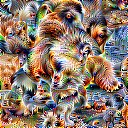

6
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.44it/s]



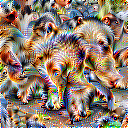

7
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.90it/s]



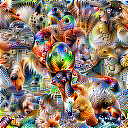

8
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.34it/s]



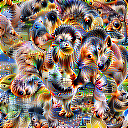

9
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.53it/s]



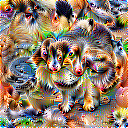

10
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.34it/s]



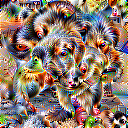

11
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.30it/s]



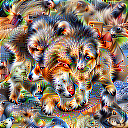

12
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.22it/s]



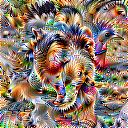

13
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.20it/s]



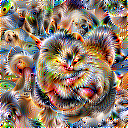

14
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.01it/s]



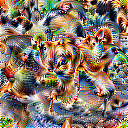

15
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.22it/s]



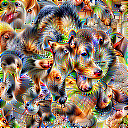

16
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.32it/s]



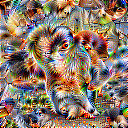

17
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.98it/s]



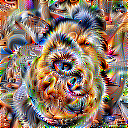

18
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.11it/s]



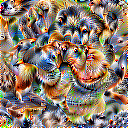

19
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.33it/s]



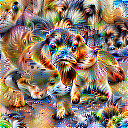

20
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.66it/s]



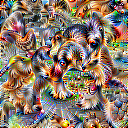

21
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.21it/s]



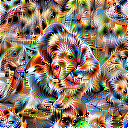

22
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.18it/s]



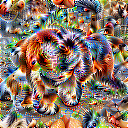

23
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.18it/s]



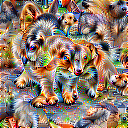

24
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.29it/s]



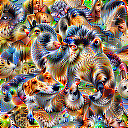

25
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.33it/s]



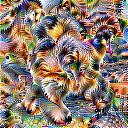

26
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.49it/s]



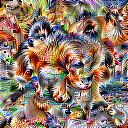

27
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.46it/s]



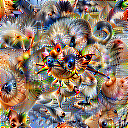

28
FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.49it/s]



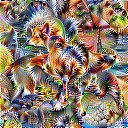

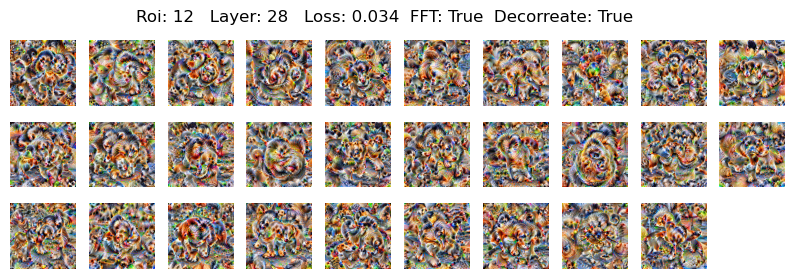

In [9]:
import matplotlib.pyplot as plt

list_of_images = []
n_neurons = 29
for i in range(0, n_neurons):
    print(i)
    print('FFT: True,  Decorrelate: True')
    param_f = lambda: param.image(128, fft=True, decorrelate=True)
    img = render.render_vis(net, 'output:'+str(i), param_f, transforms=[], show_inline=True)
    list_of_images.append(img[0][0])


f, ax = plt.subplots(n_neurons//10+1, 10, figsize = (10,n_neurons//10+1))

f.suptitle('Roi: 12   Layer: 28   Loss: 0.034  FFT: True  Decorreate: True')

for i in range(len(list_of_images)):
    ax[i//10, i%10].imshow(np.array(list_of_images[i]))
    ax[i//10, i%10].axis('off')
        
for i in range(len(list_of_images), (n_neurons//10+1)*10):
        f.delaxes(ax[i//10, i%10])

#plt.savefig('/home/jose/Desktop/Paolo_meeting/ROI_12_Layer_28_loss_0.034___fft_true_decorrelate_true.png')

0
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.09it/s]



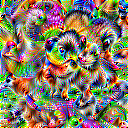

1
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 75.32it/s]



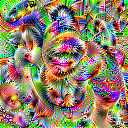

2
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 76.66it/s]



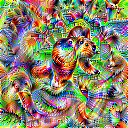

3
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.08it/s]



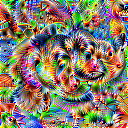

4
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.62it/s]



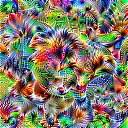

5
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.75it/s]



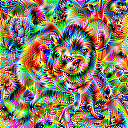

6
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.68it/s]



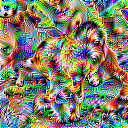

7
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.53it/s]



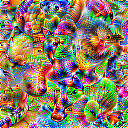

8
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.62it/s]



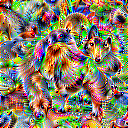

9
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.62it/s]



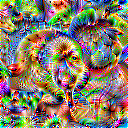

10
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.61it/s]



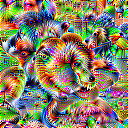

11
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.69it/s]



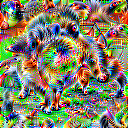

12
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.76it/s]



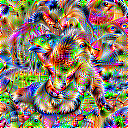

13
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.68it/s]



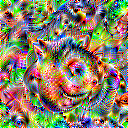

14
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.81it/s]



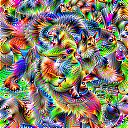

15
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.57it/s]



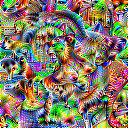

16
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.69it/s]



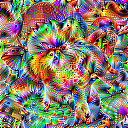

17
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.82it/s]



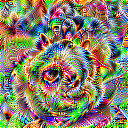

18
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.56it/s]



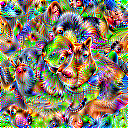

19
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.95it/s]



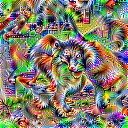

20
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.66it/s]



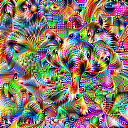

21
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.68it/s]



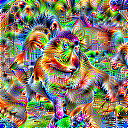

22
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.39it/s]



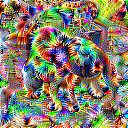

23
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.52it/s]



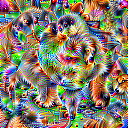

24
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.72it/s]



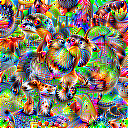

25
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.10it/s]



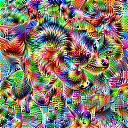

26
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.30it/s]



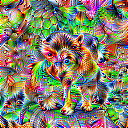

27
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.26it/s]



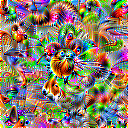

28
FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 77.50it/s]



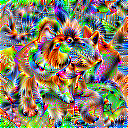

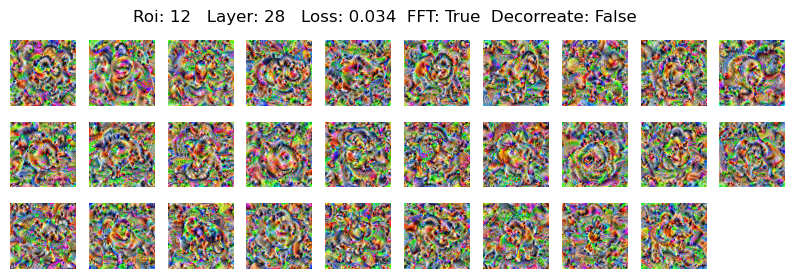

In [10]:
import matplotlib.pyplot as plt

list_of_images = []
n_neurons = 29
for i in range(0, n_neurons):
    print(i)
    print('FFT: True,  Decorrelate: False')
    param_f = lambda: param.image(128, fft=True, decorrelate=False)
    img = render.render_vis(net, 'output:'+str(i), param_f, transforms=[], show_inline=True)
    list_of_images.append(img[0][0])


f, ax = plt.subplots(n_neurons//10+1, 10, figsize = (10,n_neurons//10+1))

f.suptitle('Roi: 12   Layer: 28   Loss: 0.034  FFT: True  Decorreate: False')

for i in range(len(list_of_images)):
    ax[i//10, i%10].imshow(np.array(list_of_images[i]))
    ax[i//10, i%10].axis('off')
        
for i in range(len(list_of_images), (n_neurons//10+1)*10):
        f.delaxes(ax[i//10, i%10])

#plt.savefig('/home/jose/Desktop/Paolo_meeting/ROI_12_Layer_28_loss_0.034___fft_true_decorrelate_false.png')

0
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.00it/s]



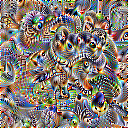

1
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.51it/s]



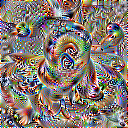

2
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.80it/s]



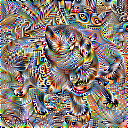

3
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.70it/s]



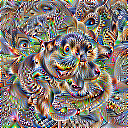

4
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.85it/s]



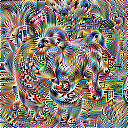

5
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.14it/s]



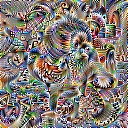

6
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.00it/s]



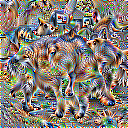

7
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.90it/s]



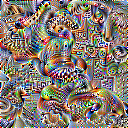

8
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.00it/s]



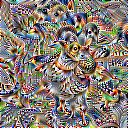

9
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.86it/s]



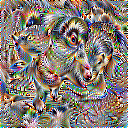

10
FFT: False,  Decorrelate: True


 25%|██▍       | 126/512 [00:01<00:05, 75.50it/s]

Interrupted optimization at step 127.



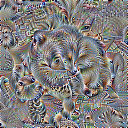

11
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 73.22it/s]



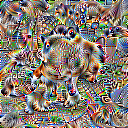

12
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.40it/s]



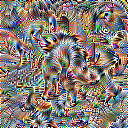

13
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.44it/s]



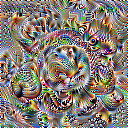

14
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 74.98it/s]



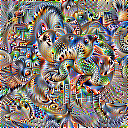

15
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.29it/s]



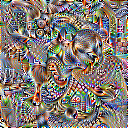

16
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.54it/s]



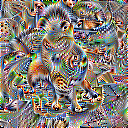

17
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.99it/s]



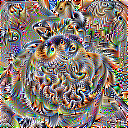

18
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.60it/s]



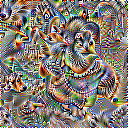

19
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 77.57it/s]



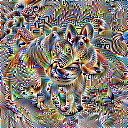

20
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 78.27it/s]



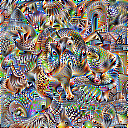

21
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 78.01it/s]



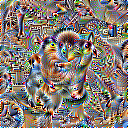

22
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.95it/s]



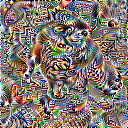

23
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 74.97it/s]



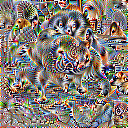

24
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.20it/s]



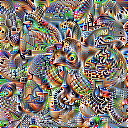

25
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.80it/s]



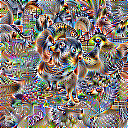

26
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.01it/s]



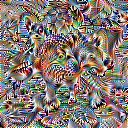

27
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.78it/s]



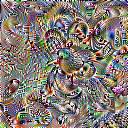

28
FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 75.60it/s]



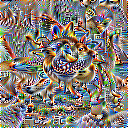

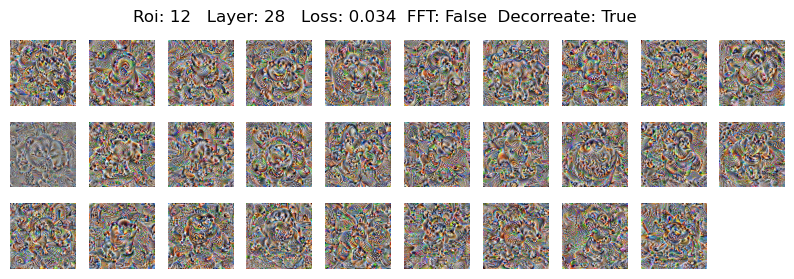

In [11]:
import matplotlib.pyplot as plt

list_of_images = []
n_neurons = 29
for i in range(0, n_neurons):
    print(i)
    print('FFT: False,  Decorrelate: True')
    param_f = lambda: param.image(128, fft=False, decorrelate=True)
    img = render.render_vis(net, 'output:'+str(i), param_f, transforms=[], show_inline=True)
    list_of_images.append(img[0][0])


f, ax = plt.subplots(n_neurons//10+1, 10, figsize = (10,n_neurons//10+1))

f.suptitle('Roi: 12   Layer: 28   Loss: 0.034  FFT: False  Decorreate: True')

for i in range(len(list_of_images)):
    ax[i//10, i%10].imshow(np.array(list_of_images[i]))
    ax[i//10, i%10].axis('off')
        
for i in range(len(list_of_images), (n_neurons//10+1)*10):
        f.delaxes(ax[i//10, i%10])

#plt.savefig('/home/jose/Desktop/Paolo_meeting/ROI_12_Layer_28_loss_0.034___fft_false_decorrelate_true.png')

In [12]:
import matplotlib.pyplot as plt

list_of_images = []
n_neurons = 29
for i in range(0, n_neurons):
    print(i)
    print('FFT: False,  Decorrelate: False')
    param_f = lambda: param.image(128, fft=False, decorrelate=False)
    img = render.render_vis(net, 'output:'+str(i), param_f, transforms=[], show_inline=False)
    list_of_images.append(img[0][0])


f, ax = plt.subplots(n_neurons//10+1, 10, figsize = (10,n_neurons//10+1))

f.suptitle('Roi: 12   Layer: 28   Loss: 0.034  FFT: False  Decorreate: False')

for i in range(len(list_of_images)):
    ax[i//10, i%10].imshow(np.array(list_of_images[i]))
    ax[i//10, i%10].axis('off')
        
for i in range(len(list_of_images), (n_neurons//10+1)*10):
        f.delaxes(ax[i//10, i%10])

#plt.savefig('/home/jose/Desktop/Paolo_meeting/ROI_12_Layer_28_loss_0.034___fft_false_decorrelate_false.png')

FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 76.30it/s]



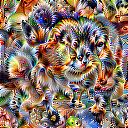

FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 78.48it/s]



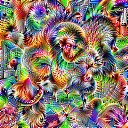

FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 78.42it/s]



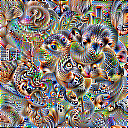

FFT: False,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 79.02it/s]



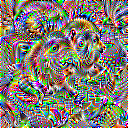

In [13]:
print('FFT: True,  Decorrelate: True')
param_f = lambda: param.image(128, fft=True, decorrelate=True)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: True,  Decorrelate: False')
param_f = lambda: param.image(128, fft=True, decorrelate=False)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: False,  Decorrelate: True')
param_f = lambda: param.image(128, fft=False, decorrelate=True)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: False,  Decorrelate: False')
param_f = lambda: param.image(128, fft=False, decorrelate=False)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

0


100%|██████████| 512/512 [00:07<00:00, 65.47it/s]


1


100%|██████████| 512/512 [00:07<00:00, 66.52it/s]


2


100%|██████████| 512/512 [00:07<00:00, 65.96it/s]


3


100%|██████████| 512/512 [00:07<00:00, 64.24it/s]


4


100%|██████████| 512/512 [00:07<00:00, 65.23it/s]


5


100%|██████████| 512/512 [00:07<00:00, 64.99it/s]


6


100%|██████████| 512/512 [00:07<00:00, 64.81it/s]


7


 34%|███▍      | 174/512 [00:02<00:05, 66.32it/s]
(eog:123735): Gtk-WARNING **: 14:27:02.872: Negative content width -6 (allocation 18, extents 12x12) while allocating gadget (node label, owner GtkLabel)
 94%|█████████▍| 481/512 [00:07<00:00, 64.80it/s]


Interrupted optimization at step 482.
8


  1%|▏         | 7/512 [00:00<00:08, 61.39it/s]
(eog:208093): Gtk-WARNING **: 14:27:07.910: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:08<00:00, 62.07it/s]


9


  1%|▏         | 7/512 [00:00<00:08, 61.34it/s]
(eog:208152): Gtk-WARNING **: 14:27:16.159: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:07<00:00, 65.29it/s]


10


100%|██████████| 512/512 [00:07<00:00, 66.49it/s]


11


100%|██████████| 512/512 [00:07<00:00, 64.77it/s]


12


 42%|████▏     | 217/512 [00:03<00:04, 64.06it/s]


Interrupted optimization at step 218.
13


  1%|▏         | 7/512 [00:00<00:08, 61.47it/s]
(eog:208294): Gtk-WARNING **: 14:27:43.160: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:08<00:00, 62.37it/s]


14


  1%|▏         | 7/512 [00:00<00:08, 60.19it/s]
(eog:208353): Gtk-WARNING **: 14:27:51.394: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:07<00:00, 65.55it/s]


15


100%|██████████| 512/512 [00:07<00:00, 65.41it/s]


16


100%|██████████| 512/512 [00:07<00:00, 65.08it/s]


17


100%|██████████| 512/512 [00:07<00:00, 65.47it/s]


18


100%|██████████| 512/512 [00:07<00:00, 65.03it/s]


19


100%|██████████| 512/512 [00:07<00:00, 65.55it/s]


20


100%|██████████| 512/512 [00:07<00:00, 65.31it/s]


21


100%|██████████| 512/512 [00:07<00:00, 65.47it/s]


22


100%|██████████| 512/512 [00:07<00:00, 65.27it/s]


23


100%|██████████| 512/512 [00:07<00:00, 65.31it/s]


24


100%|██████████| 512/512 [00:07<00:00, 64.48it/s]


25


  1%|▏         | 7/512 [00:00<00:08, 62.33it/s]
(eog:208725): Gtk-WARNING **: 14:29:18.106: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:07<00:00, 65.03it/s]


26


  1%|▏         | 7/512 [00:00<00:08, 61.62it/s]
(eog:208784): Gtk-WARNING **: 14:29:26.032: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:07<00:00, 64.81it/s]


27


  1%|▏         | 7/512 [00:00<00:08, 62.98it/s]
(eog:208844): Gtk-WARNING **: 14:29:33.973: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.
100%|██████████| 512/512 [00:07<00:00, 65.84it/s]


28


100%|██████████| 512/512 [00:07<00:00, 64.68it/s]

(eog:208938): Gtk-WARNING **: 14:29:49.726: Could not load a pixbuf from icon theme.
This may indicate that pixbuf loaders or the mime database could not be found.


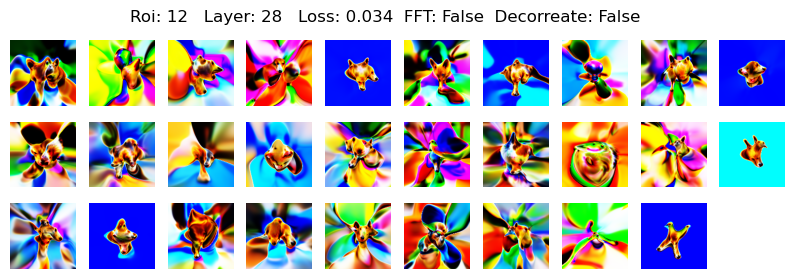

In [14]:
cppn_param_f = lambda: param.cppn(128)
cppn_opt     = lambda params: torch.optim.Adam(params, 5e-3)

list_of_images = []

for i in range(0, 29):
    print(i)
    img = render.render_vis(net, 'output:'+str(i), cppn_param_f, cppn_opt, transforms=[], show_inline=1)
    list_of_images.append(img[0][0])


f, ax = plt.subplots(n_neurons//10+1, 10, figsize = (10,n_neurons//10+1))

f.suptitle('Roi: 12   Layer: 28   Loss: 0.034  FFT: False  Decorreate: False')

for i in range(len(list_of_images)):
    ax[i//10, i%10].imshow(np.array(list_of_images[i]))
    ax[i//10, i%10].axis('off')
        
for i in range(len(list_of_images), (n_neurons//10+1)*10):
        f.delaxes(ax[i//10, i%10])

#plt.savefig('/home/jose/Desktop/Paolo_meeting/ROI_12_Layer_28_loss_0.034___ccpn_param.png')

100%|██████████| 512/512 [00:08<00:00, 62.82it/s]



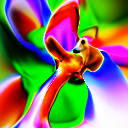

In [15]:
cppn_param_f = lambda: param.cppn(128)
cppn_opt     = lambda params: torch.optim.Adam(params, 5e-3)
_ = render.render_vis(net, 'output:15', cppn_param_f, cppn_opt, transforms=[], show_inline=True)

In [16]:
all_transforms = [
#transform.pad(2),
transform.jitter(8),
transform.random_scale([n/1000. for n in range(975, 1050)]),
transform.random_rotate(list(range(-5,5))),
transform.jitter(4)
]

batch_param_f = lambda: param.image(128, batch=5, fft=True, decorrelate=True)
cppn_opt = lambda params: torch.optim.Adam(params, 1e-2, weight_decay=1e-4)



In [17]:
#################################################################

FFT: True,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 74.63it/s]



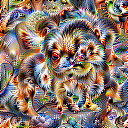

FFT: True,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 76.23it/s]



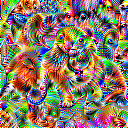

FFT: False,  Decorrelate: True


100%|██████████| 512/512 [00:06<00:00, 73.93it/s]



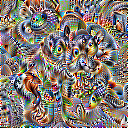

FFT: False,  Decorrelate: False


100%|██████████| 512/512 [00:06<00:00, 76.12it/s]



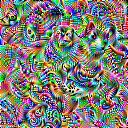

In [18]:
print('FFT: True,  Decorrelate: True')
param_f = lambda: param.image(128, fft=True, decorrelate=True)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: True,  Decorrelate: False')
param_f = lambda: param.image(128, fft=True, decorrelate=False)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: False,  Decorrelate: True')
param_f = lambda: param.image(128, fft=False, decorrelate=True)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

print('FFT: False,  Decorrelate: False')
param_f = lambda: param.image(128, fft=False, decorrelate=False)
_ = render.render_vis(net, 'output:0', param_f, transforms=[], show_inline=True)

0


100%|██████████| 512/512 [00:07<00:00, 65.45it/s]



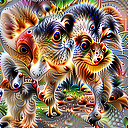

--------------------
1


100%|██████████| 512/512 [00:07<00:00, 65.56it/s]



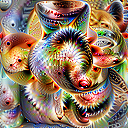

--------------------
2


100%|██████████| 512/512 [00:07<00:00, 65.94it/s]



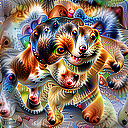

--------------------
3


100%|██████████| 512/512 [00:07<00:00, 65.84it/s]



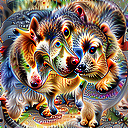

--------------------
4


100%|██████████| 512/512 [00:07<00:00, 66.01it/s]



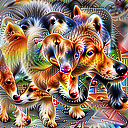

--------------------
5


100%|██████████| 512/512 [00:07<00:00, 64.76it/s]



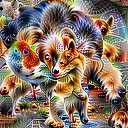

--------------------
6


100%|██████████| 512/512 [00:07<00:00, 66.20it/s]



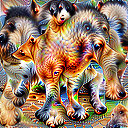

--------------------
7


100%|██████████| 512/512 [00:07<00:00, 66.00it/s]



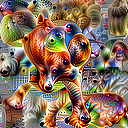

--------------------
8


100%|██████████| 512/512 [00:07<00:00, 65.86it/s]



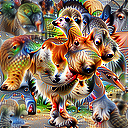

--------------------
9


100%|██████████| 512/512 [00:07<00:00, 65.96it/s]



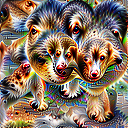

--------------------
10


100%|██████████| 512/512 [00:07<00:00, 65.66it/s]



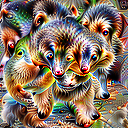

--------------------
11


100%|██████████| 512/512 [00:07<00:00, 65.49it/s]



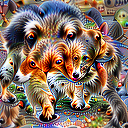

--------------------
12


100%|██████████| 512/512 [00:08<00:00, 63.02it/s]



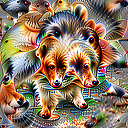

--------------------
13


100%|██████████| 512/512 [00:07<00:00, 67.05it/s]



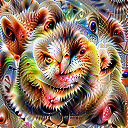

--------------------
14


100%|██████████| 512/512 [00:07<00:00, 66.88it/s]



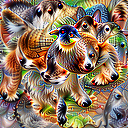

--------------------
15


100%|██████████| 512/512 [00:07<00:00, 66.86it/s]



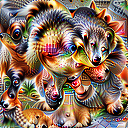

--------------------
16


100%|██████████| 512/512 [00:07<00:00, 66.87it/s]



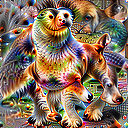

--------------------
17


100%|██████████| 512/512 [00:07<00:00, 66.69it/s]



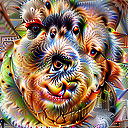

--------------------
18


100%|██████████| 512/512 [00:07<00:00, 66.74it/s]



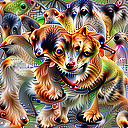

--------------------
19


100%|██████████| 512/512 [00:07<00:00, 66.68it/s]



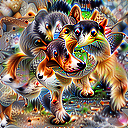

--------------------
20


100%|██████████| 512/512 [00:07<00:00, 66.49it/s]



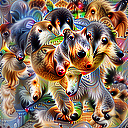

--------------------
21


100%|██████████| 512/512 [00:07<00:00, 66.66it/s]



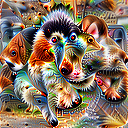

--------------------
22


100%|██████████| 512/512 [00:08<00:00, 62.30it/s]



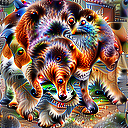

--------------------
23


100%|██████████| 512/512 [00:08<00:00, 61.62it/s]



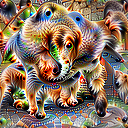

--------------------
24


100%|██████████| 512/512 [00:08<00:00, 61.19it/s]



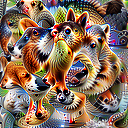

--------------------
25


100%|██████████| 512/512 [00:07<00:00, 65.45it/s]



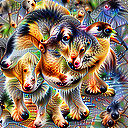

--------------------
26


100%|██████████| 512/512 [00:07<00:00, 66.39it/s]



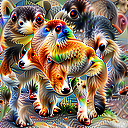

--------------------
27


100%|██████████| 512/512 [00:07<00:00, 66.93it/s]



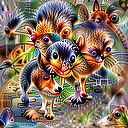

--------------------
28


100%|██████████| 512/512 [00:07<00:00, 66.53it/s]



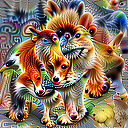

--------------------
29


  0%|          | 0/512 [00:00<?, ?it/s]


IndexError: index 29 is out of bounds for dimension 1 with size 29

In [19]:
list_imgs = []
for i in range(0, 100):
    print(i)
    img = render.render_vis(net, 'output:'+str(i), show_inline = 1)
    list_imgs.append(img[0][0, :, :, :])
    print('--------------------')

In [ ]:
import matplotlib.pyplot as plt

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43


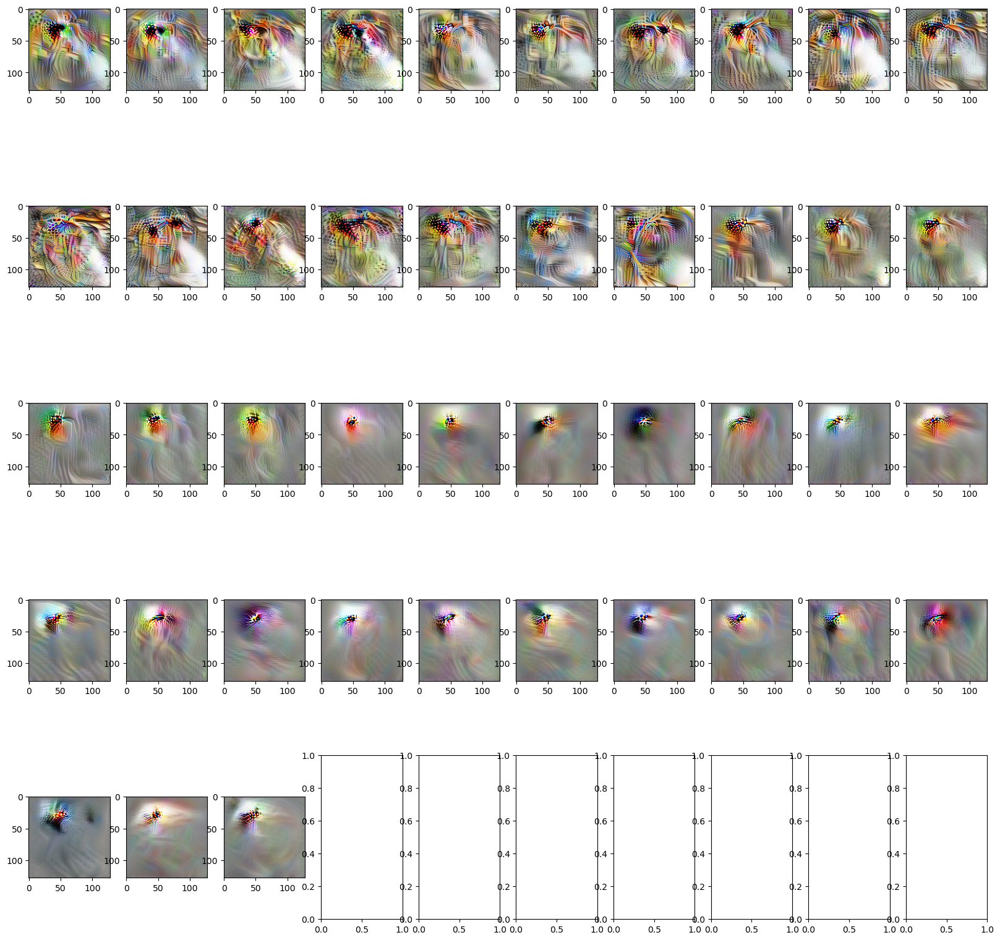

In [ ]:
import itertools
f, ax = plt.subplots(5,10, figsize=(20,20))
for n, (i, j) in enumerate(itertools.product(list(range(10)), list(range(10)))):
    print(n)
    if n == 43:
        break
    ax[i, j].imshow(list_imgs[n])
#plt.savefig('Model_3_10__neurons_lucent_amazing_fit.png', dpi=150)

In [ ]:

#plt.savefig('Model_3_10__neurons_lucent_great_fit.png', dpi=150)

<Figure size 640x480 with 0 Axes>

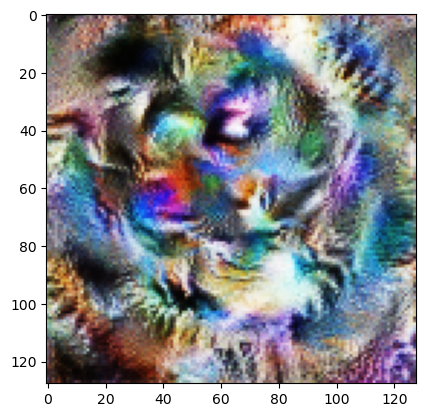

In [ ]:
plt.imshow(img[0][0, :, :, :])

/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jose/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


conv_layer:   0 <class 'int'>
FTE:          [0, 2, 5, 7, 10, 12, 14, 16, 19, 21, 23, 25, 28, 30, 32, 34]
conv in FTE True



features.0
Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
[64, 224, 224, 43]
0


100%|██████████| 512/512 [00:10<00:00, 47.16it/s]



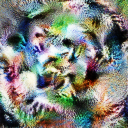

--------------------
1


100%|██████████| 512/512 [00:10<00:00, 47.37it/s]



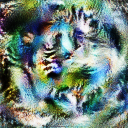

--------------------
2


100%|██████████| 512/512 [00:10<00:00, 47.52it/s]



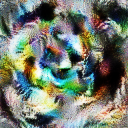

--------------------
3


100%|██████████| 512/512 [00:10<00:00, 47.69it/s]



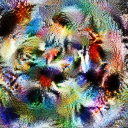

--------------------
4


100%|██████████| 512/512 [00:10<00:00, 47.35it/s]



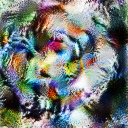

--------------------
5


100%|██████████| 512/512 [00:10<00:00, 47.67it/s]



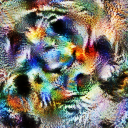

--------------------
6


100%|██████████| 512/512 [00:10<00:00, 47.94it/s]



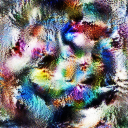

--------------------
7


100%|██████████| 512/512 [00:10<00:00, 47.98it/s]



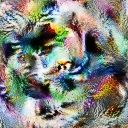

--------------------
8


100%|██████████| 512/512 [00:10<00:00, 47.96it/s]



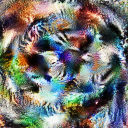

--------------------
9


100%|██████████| 512/512 [00:10<00:00, 48.00it/s]



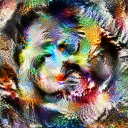

--------------------
10


100%|██████████| 512/512 [00:10<00:00, 47.95it/s]



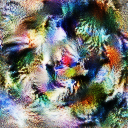

--------------------
11


100%|██████████| 512/512 [00:10<00:00, 47.97it/s]



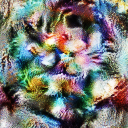

--------------------
12


100%|██████████| 512/512 [00:10<00:00, 47.04it/s]



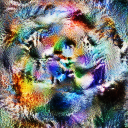

--------------------
13


100%|██████████| 512/512 [00:10<00:00, 47.69it/s]



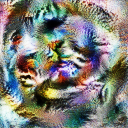

--------------------
14


100%|██████████| 512/512 [00:10<00:00, 48.21it/s]



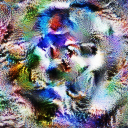

--------------------
15


100%|██████████| 512/512 [00:10<00:00, 48.23it/s]



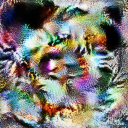

--------------------
16


100%|██████████| 512/512 [00:10<00:00, 48.28it/s]



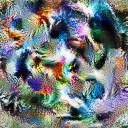

--------------------
17


100%|██████████| 512/512 [00:10<00:00, 48.24it/s]



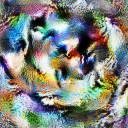

--------------------
18


100%|██████████| 512/512 [00:10<00:00, 48.27it/s]



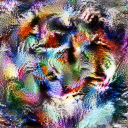

--------------------
19


100%|██████████| 512/512 [00:10<00:00, 48.33it/s]



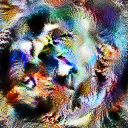

--------------------
20


100%|██████████| 512/512 [00:10<00:00, 48.04it/s]



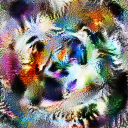

--------------------
21


100%|██████████| 512/512 [00:10<00:00, 48.27it/s]



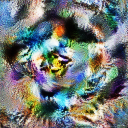

--------------------
22


100%|██████████| 512/512 [00:10<00:00, 48.30it/s]



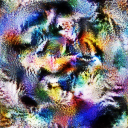

--------------------
23


100%|██████████| 512/512 [00:10<00:00, 48.32it/s]



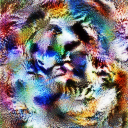

--------------------
24


100%|██████████| 512/512 [00:10<00:00, 48.31it/s]



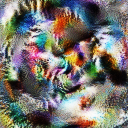

--------------------
25


100%|██████████| 512/512 [00:10<00:00, 48.31it/s]



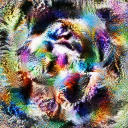

--------------------
26


100%|██████████| 512/512 [00:10<00:00, 48.42it/s]



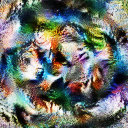

--------------------
27


100%|██████████| 512/512 [00:10<00:00, 48.36it/s]



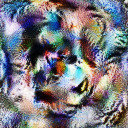

--------------------
28


100%|██████████| 512/512 [00:10<00:00, 48.42it/s]



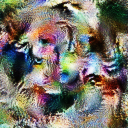

--------------------
29


100%|██████████| 512/512 [00:10<00:00, 48.38it/s]



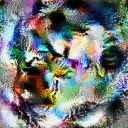

--------------------
30


100%|██████████| 512/512 [00:10<00:00, 48.44it/s]



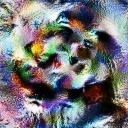

--------------------
31


100%|██████████| 512/512 [00:10<00:00, 48.38it/s]



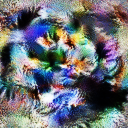

--------------------
32


100%|██████████| 512/512 [00:11<00:00, 46.31it/s]



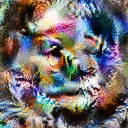

--------------------
33


100%|██████████| 512/512 [00:10<00:00, 47.51it/s]



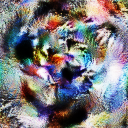

--------------------
34


100%|██████████| 512/512 [00:10<00:00, 47.40it/s]



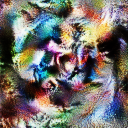

--------------------
35


100%|██████████| 512/512 [00:10<00:00, 47.81it/s]



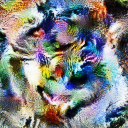

--------------------
36


100%|██████████| 512/512 [00:10<00:00, 47.70it/s]



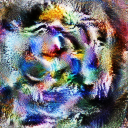

--------------------
37


100%|██████████| 512/512 [00:10<00:00, 47.76it/s]



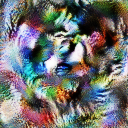

--------------------
38


100%|██████████| 512/512 [00:10<00:00, 47.77it/s]



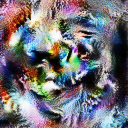

--------------------
39


100%|██████████| 512/512 [00:10<00:00, 47.74it/s]



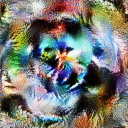

--------------------
40


100%|██████████| 512/512 [00:10<00:00, 47.96it/s]



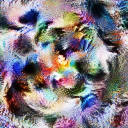

--------------------
41


100%|██████████| 512/512 [00:10<00:00, 47.79it/s]



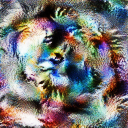

--------------------
42


100%|██████████| 512/512 [00:10<00:00, 48.18it/s]



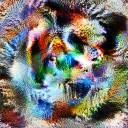

--------------------


NameError: name 'itertools' is not defined

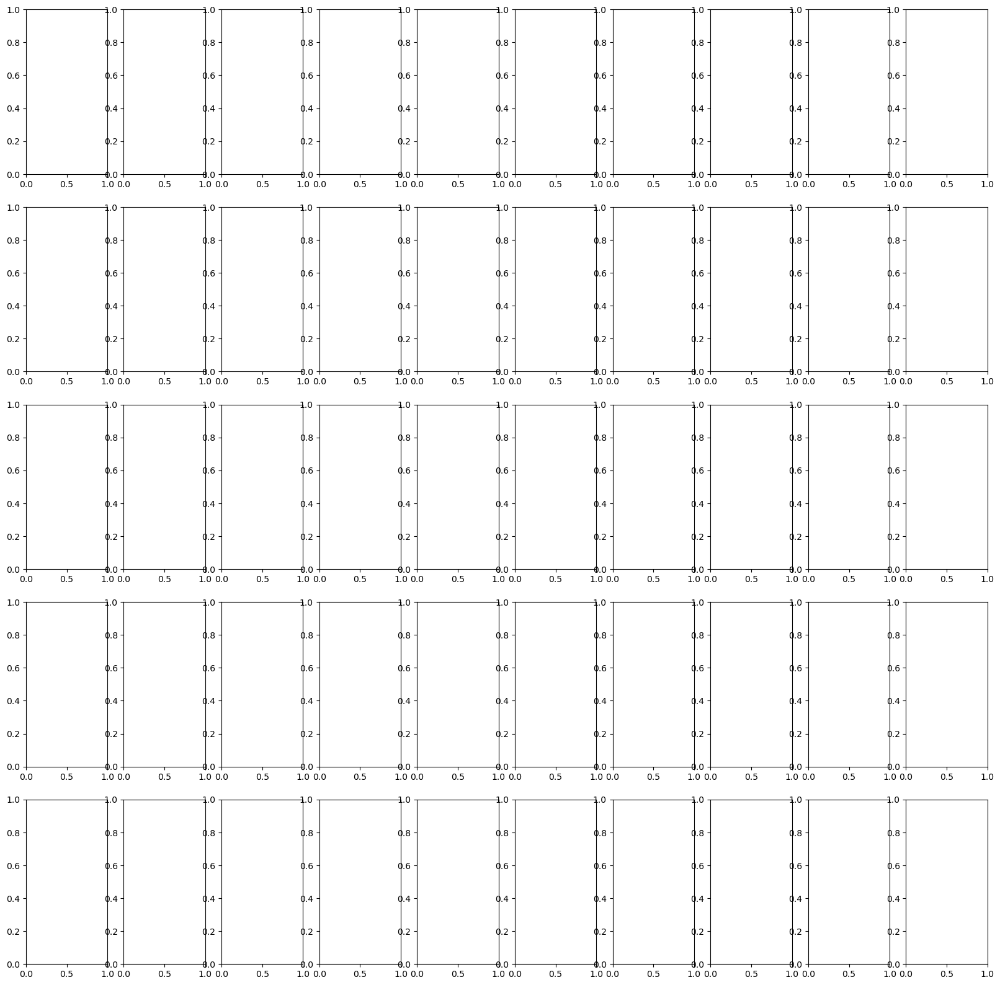

In [21]:
import torch
from lucent.modelzoo import vgg19, util
from cadena_model_vgg import VggModel

vgg_pretrained = vgg19(pretrained = True)

gpu_to_use = 0
n_neurons = 43
layer = 0


GPU = torch.cuda.is_available()
net = VggModel(pretrained_model=vgg_pretrained, conv_layer=layer, num_neurons=n_neurons, device = torch.device("cuda:"+str(gpu_to_use) if GPU else "cpu"))
net.cuda()


list_imgs_untrained = []
for i in range(0, 43):
    print(i)
    img = render.render_vis(net, 'output:'+str(i), show_inline = 1)
    list_imgs_untrained.append(img[0][0, :, :, :])
    print('--------------------')

f, ax = plt.subplots(5,10, figsize=(20,20))
for n, (i, j) in enumerate(itertools.product(list(range(10)), list(range(10)))):
    print(n)
    if n == 43:
        break
    ax[i, j].imshow(list_imgs_untrained[n])
#plt.savefig('Model_3_10__untrained_neurons_lucent.png', dpi=150)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43


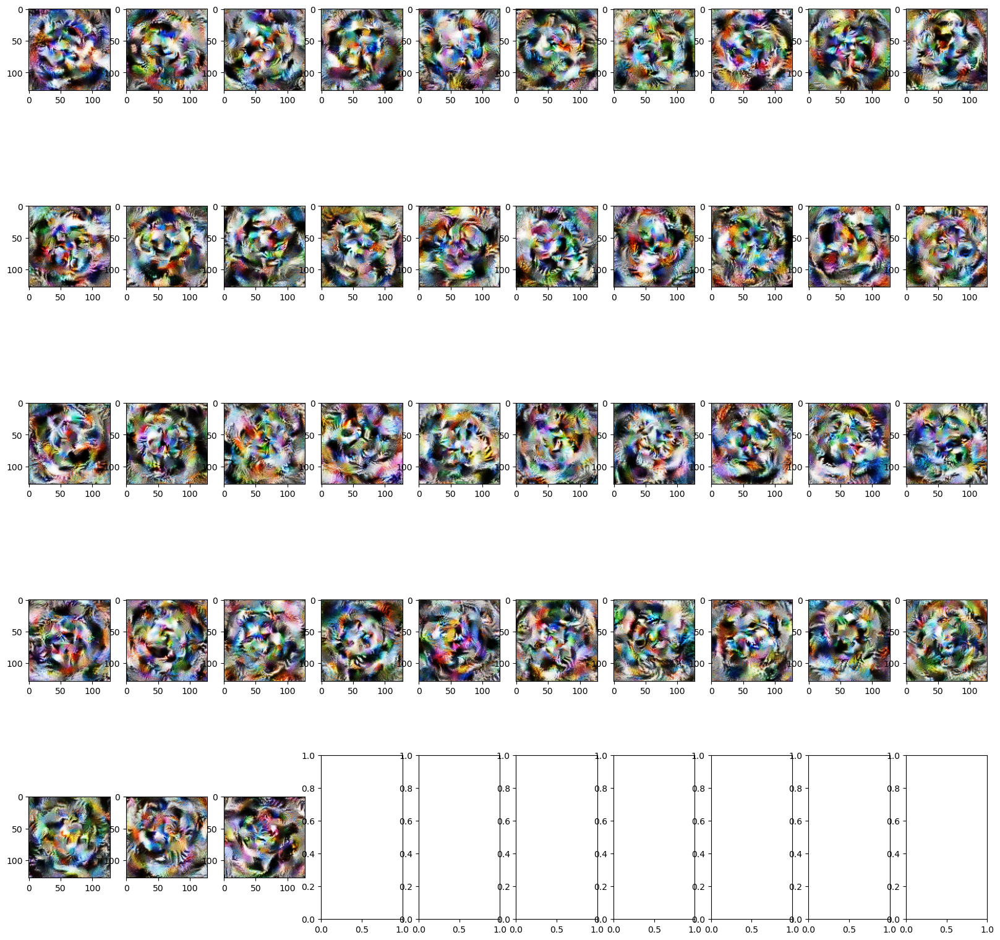

In [ ]:
f, ax = plt.subplots(5,10, figsize=(20,20))
for n, (i, j) in enumerate(itertools.product(list(range(10)), list(range(10)))):
    print(n)
    if n == 43:
        break
    ax[i, j].imshow(list_imgs_untrained[n])
#plt.savefig('Model_3_10__untrained_neurons_lucent.png', dpi=150)